# Exploring the radial properties of the hot-ICM temperature

<span style="color:red">This should currently be considered preliminary, as there are some problems with observation selection for spectral generation for some of these large clusters - also our improved background method isn't fully implemented. Also also, we are still using the MCXC defined coordinates</span>

<span style="color:red">**We do not currently make the temperature profile saves available, as I need to create a better file format for them (i.e. FITS based), and they are probably too large for GitHub right now.**</span>

## Import Statements

In [70]:
import pandas as pd
pd.set_option('display.max_columns', 500)
import numpy as np
from astropy.units import Quantity
from astropy.cosmology import LambdaCDM
from shutil import rmtree
from matplotlib import pyplot as plt
from matplotlib.ticker import FuncFormatter
import os

import xga
# This just sets the number of cores this analysis is allowed to use
xga.NUM_CORES = 50
# This is a bodge that will only work because xga_output in notebooks has already been defined, XGA
#  will be made to handle this more gracefully at some point
temp_dir = xga.OUTPUT
actual_dir = temp_dir.split('notebooks/')[0]+'notebooks/xga_output/'
xga.OUTPUT = actual_dir
xga.utils.OUTPUT = actual_dir
# As currently XGA will setup an xga_output directory in our current directory, I remove it to keep it all clean
if os.path.exists('xga_output'):
    rmtree('xga_output')
from xga.samples import ClusterSample
from xga.sourcetools.temperature import min_cnt_proj_temp_prof  
from xga.sas.phot import emosaic
from xga.imagetools.misc import physical_rad_to_pix
from xga.exceptions import NoProductAvailableError
from xga.products import BaseAggregateProfile1D
from xga.imagetools.misc import pix_deg_scale

%matplotlib inline

xga.__version__

'0+unknown'

## Creating Storage Directories

We ensure that the storage directories within which we will store output files from this analysis have been created:

In [85]:
stor_dir = '../../outputs/results/profiles/projected_temperature/'
if not os.path.exists(stor_dir):
    os.makedirs(stor_dir)
    
fig_dir = '../../outputs/figures/profiles/projected_temperature/'
if not os.path.exists(fig_dir):
    os.makedirs(fig_dir)
    
# And the same deal for projected metallicity
stor_dir_met = '../../outputs/results/profiles/projected_metallicity/'
if not os.path.exists(stor_dir_met):
    os.makedirs(stor_dir_met)
    
fig_dir_met = '../../outputs/figures/profiles/projected_metallicity/'
if not os.path.exists(fig_dir_met):
    os.makedirs(fig_dir_met)
    
# We also add a directory for side-by-side profile + ratemaps views
fig_dir_diag = '../../outputs/figures/profiles/projected_temperature_ratemaps/'
if not os.path.exists(fig_dir_diag):
    os.makedirs(fig_dir_diag)

## Define the cosmology

We make use of a concordance flat LambdaCDM cosmology during the course of this analysis:

In [2]:
cosmo = LambdaCDM(70, 0.3, 0.7)

## Reading the sample file

We read in the sample file to get the information we need to set up an XGA ClusterSample:

In [3]:
samp = pd.read_csv('../../outputs/results/ltr_r500_metfree_pipeline_results.csv')
rad_hist = pd.read_csv('../../outputs/results/ltr_r500_metfree_radii_history.csv')

samp = samp[~np.isnan(samp['r500'])]

temp_samp = samp.merge(rad_hist)
samp = samp[temp_samp['converged'].values]
samp.reset_index(drop=True, inplace=True)
samp

,name,ra,dec,redshift,r500,Tx500,Tx500-,Tx500+,Lx500_0.5-2.0,Lx500_0.5-2.0-,Lx500_0.5-2.0+,Lx500_0.01-100.0,Lx500_0.01-100.0-,Lx500_0.01-100.0+,Lx500_0.4-2.4,Lx500_0.4-2.4-,Lx500_0.4-2.4+,Zmet500,Zmet500-,Zmet500+,Tx500ce,Tx500ce-,Tx500ce+,Lx500ce_0.5-2.0,Lx500ce_0.5-2.0-,Lx500ce_0.5-2.0+,Lx500ce_0.01-100.0,Lx500ce_0.01-100.0-,Lx500ce_0.01-100.0+,Lx500ce_0.4-2.4,Lx500ce_0.4-2.4-,Lx500ce_0.4-2.4+,Zmet500ce,Zmet500ce-,Zmet500ce+
0,LoVoCCS-4B,10.451487,-9.460007,0.0555,1144.764889,5.55319,0.049256,0.049231,6.827098e+43,2.376048e+42,1.631782e+42,2.323190e+44,7.937256e+42,6.504758e+42,8.728831e+43,2.514485e+42,2.364832e+42,0.211546,0.013172,0.013220,5.649450,0.050833,0.050805,5.588954e+43,2.263843e+42,2.262334e+42,1.917376e+44,5.887959e+42,5.199501e+42,7.148396e+43,2.249453e+42,2.175760e+42,2.148440e-01,1.389098e-02,0.013947
1,LoVoCCS-5,303.157313,-56.845978,0.0556,1119.049232,5.35600,0.044514,0.044392,1.603958e+44,7.309935e+42,6.470704e+42,5.365145e+44,2.800941e+43,2.237160e+43,2.049202e+44,8.969817e+42,9.452302e+42,0.202952,0.012255,0.012266,5.332650,0.054810,0.054678,1.099878e+44,6.902062e+42,8.983429e+42,3.665132e+44,2.810300e+43,1.507589e+43,1.405310e+44,1.059858e+43,8.959700e+42,1.787680e-01,1.477549e-02,0.014669
2,LoVoCCS-7,330.480000,-59.950000,0.0980,1149.344414,5.88148,0.063561,0.063588,3.036659e+44,1.317301e+42,9.510817e+41,1.065809e+45,5.885371e+42,6.795285e+42,3.887160e+44,1.697895e+42,1.515029e+42,0.239521,0.015216,0.015421,5.648660,0.083715,0.083644,2.024872e+44,1.160792e+42,1.082606e+42,6.952759e+44,6.718476e+42,5.090248e+42,2.590291e+44,1.123953e+42,1.297618e+42,1.986970e-01,2.072736e-02,0.020960
3,LoVoCCS-9,67.830487,-61.447401,0.0589,1209.871886,6.80800,0.045162,0.040867,1.551936e+44,2.095797e+42,2.155744e+42,5.779741e+44,6.922548e+42,7.161609e+42,1.993022e+44,2.706919e+42,2.048619e+42,0.182259,0.009428,0.009464,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,LoVoCCS-10,194.840000,-4.190000,0.0845,1129.503907,5.57022,0.089904,0.089403,3.010015e+44,1.873288e+42,1.386844e+42,1.033089e+45,8.300567e+42,9.731622e+42,3.847086e+44,2.420158e+42,2.185967e+42,0.289258,0.026268,0.026399,5.441610,0.133585,0.145661,1.886215e+44,1.467555e+42,1.376056e+42,6.349937e+44,9.826994e+42,9.161462e+42,2.411354e+44,2.040795e+42,1.746662e+42,1.727650e-01,3.694711e-02,0.037878
5,LoVoCCS-13,49.490000,-44.240000,0.0752,944.951945,4.04929,0.010001,0.008223,2.487713e+44,2.572661e+41,3.935470e+41,7.395135e+44,1.306181e+42,1.220603e+42,3.147113e+44,4.325164e+41,4.851989e+41,0.408156,0.003827,0.003683,4.175000,0.020869,0.020853,1.150769e+44,3.826278e+41,2.498732e+41,3.434262e+44,1.201204e+42,1.409299e+42,1.461498e+44,3.803062e+41,3.996260e+41,1.862520e-01,6.082948e-03,0.006151
6,LoVoCCS-15,351.330000,-12.130000,0.0852,892.237349,3.69158,0.009654,0.009652,2.497428e+44,5.977186e+41,5.825902e+41,7.091232e+44,1.514782e+42,1.692742e+42,3.155329e+44,7.925565e+41,7.076171e+41,0.307163,0.003473,0.003500,3.468040,0.020122,0.020179,1.007805e+44,3.536950e+41,3.119673e+41,2.774421e+44,1.322158e+42,1.459729e+42,1.274050e+44,4.665354e+41,5.780774e+41,1.691500e-01,6.379877e-03,0.006480
7,LoVoCCS-18,194.671250,-1.756944,0.0845,1043.615449,4.88707,0.035615,0.036800,2.626842e+44,6.617313e+41,5.368524e+41,8.445588e+44,2.696365e+42,3.308680e+42,3.348247e+44,6.193924e+41,8.766117e+41,0.228613,0.010306,0.010465,4.641090,0.052859,0.052812,1.601263e+44,5.053342e+41,5.073544e+41,4.993763e+44,3.915220e+42,3.025418e+42,2.040632e+44,6.994546e+41,6.546816e+41,1.239060e-01,1.386012e-02,0.014070
8,LoVoCCS-22,308.694130,-35.823600,0.0894,1010.640028,4.61534,0.086575,0.083052,1.808120e+44,9.295551e+41,1.238944e+42,5.628155e+44,5.714323e+42,5.529899e+42,2.303525e+44,1.300633e+42,1.624029e+42,0.133224,0.021775,0.022065,4.602970,0.101577,0.097804,1.488436e+44,1.231699e+42,1.133790e+42,4.628517e+44,6.766373e+42,4.815250e+42,1.896058e+44,1.196915e+42,1.289834e+42,1.367440e-01,2.642274e-02,0.025670
9,LoVoCCS-24,342.487500,-64.429444,0.0940,1039.992188,4.87439,0.047461,0

## Set up an XGA ClusterSample

We set up an XGA ClusterSample to help us manage all the data and analyse the objects. 

<span style="color:red">The threshold for an observation being determined as relevant is set to 70% of the $R_{500}$ being on a particular observation.</span> 

In [ ]:
# This one had that fucking 'None has no usable attribute error'
# samp = samp[~samp.index.isin([65])]

In [4]:
ra = samp['ra'].values
dec = samp['dec'].values
name = samp['name'].values
z = samp['redshift'].values
r500 = Quantity(samp['r500'].values, 'kpc')

srcs = ClusterSample(ra, dec, z, name, r500=r500, use_peak=False, clean_obs=True, clean_obs_reg='r500', 
                     clean_obs_threshold=0.7, cosmology=cosmo, load_fits=True)

Setting up Galaxy Clusters: 100%|██████████| 46/46 [04:10<00:00,  5.46s/it]
/tmp/local/35931180/ipykernel_33728/298872034.py:7: UserWarning: The following do not appear to have any XMM data, and will not be included in the sample (can also check .failed_names); LoVoCCS-4B, LoVoCCS-5, LoVoCCS-9
  srcs = ClusterSample(ra, dec, z, name, r500=r500, use_peak=False, clean_obs=True, clean_obs_reg='r500',
/mnt/home/turne540/software/anaconda3/envs/xga_env/lib/python3.8/site-packages/xga/samples/extended.py:279: UserWarning: Non-fatal warnings occurred during the declaration of some sources, to access them please use the suppressed_warnings property of this sample.
  self._check_source_warnings()


## Removing problematic observations

In [ ]:
# srcs['LoVoCCS-40'].disassociate_obs({'0502671101': ['mos2']})

## Generating projected temperature and metallicity profiles

### Minimum counts = 1500

In [5]:
rads = min_cnt_proj_temp_prof(srcs, srcs.r500, Quantity(1500, 'ct'), one_rmf=False, freeze_met=False)

/mnt/home/turne540/software/anaconda3/envs/xga_env/lib/python3.8/site-packages/xga/sourcetools/temperature.py:508: UserWarning: The requested annuli for LoVoCCS-48B cannot be created, the data quality is too low. As such a set of four annuli will be returned
  rads, cnts, ma = _cnt_bins(src, out_rad_vals[src_ind], min_cnt, min_width, lo_en, hi_en, psf_corr=psf_corr,
/mnt/home/turne540/software/anaconda3/envs/xga_env/lib/python3.8/site-packages/xga/sourcetools/temperature.py:508: UserWarning: The requested annuli for LoVoCCS-89 cannot be created, the data quality is too low. As such a set of four annuli will be returned
  rads, cnts, ma = _cnt_bins(src, out_rad_vals[src_ind], min_cnt, min_width, lo_en, hi_en, psf_corr=psf_corr,
Generating products of type(s) annular spectrum set components: 100%|██████████| 2803/2803 [9:03:01<00:00, 11.62s/it]   
Running XSPEC Fits: 100%|██████████| 683/683 [2:25:37<00:00, 12.79s/it]  
/mnt/home/turne540/software/anaconda3/envs/xga_env/lib/python3.8/sit

We (temporarily) store the measured projected temperatures/metallicities (and the central position/width of their annular bins) in csvs, indicating in the name which minimum count was used. This will later be replaced by simply including XGA output profile files in the repository, but we first need to create a better way of outputting those profiles:

In [41]:
for rad_ind, rad in enumerate(rads):
    src = srcs[rad_ind]
    try:
        t_prof = src.get_proj_temp_profiles(radii=rad)
        
        data = np.concatenate([t_prof.values.value[..., None], t_prof.values_err.value[..., None], 
                               t_prof.radii.value[..., None], t_prof.radii_err.value[..., None]], axis=1)
        
        tp_df = pd.DataFrame(data, columns=['Tx', 'Tx_err', 'rad', 'rad_width']).round(3)
        file_name = "{n}_tproj_min1500ct_toR500.csv".format(n=src.name)
        tp_df.to_csv(stor_dir + file_name)
        
        met_prof = src.get_combined_profiles('1d_proj_metallicity', radii=rad)
        
        data = np.concatenate([met_prof.values.value[..., None], met_prof.values_err.value[..., None], 
                               met_prof.radii.value[..., None], met_prof.radii_err.value[..., None]], axis=1)
        
        metp_df = pd.DataFrame(data, columns=['met', 'met_err', 'rad', 'rad_width']).round(3)
        file_name = "{n}_metproj_min1500ct_toR500.csv".format(n=src.name)
        tp_df.to_csv(stor_dir_met + file_name)
        
    except NoProductAvailableError:
        pass

### Minimum counts = 3000

In [6]:
rads_3000 = min_cnt_proj_temp_prof(srcs, srcs.r500, Quantity(3000, 'ct'), one_rmf=False, freeze_met=False)

/mnt/home/turne540/software/anaconda3/envs/xga_env/lib/python3.8/site-packages/xga/sourcetools/temperature.py:508: UserWarning: The requested annuli for LoVoCCS-48B cannot be created, the data quality is too low. As such a set of four annuli will be returned
  rads, cnts, ma = _cnt_bins(src, out_rad_vals[src_ind], min_cnt, min_width, lo_en, hi_en, psf_corr=psf_corr,
/mnt/home/turne540/software/anaconda3/envs/xga_env/lib/python3.8/site-packages/xga/sourcetools/temperature.py:508: UserWarning: The requested annuli for LoVoCCS-58 cannot be created, the data quality is too low. As such a set of four annuli will be returned
  rads, cnts, ma = _cnt_bins(src, out_rad_vals[src_ind], min_cnt, min_width, lo_en, hi_en, psf_corr=psf_corr,
/mnt/home/turne540/software/anaconda3/envs/xga_env/lib/python3.8/site-packages/xga/sourcetools/temperature.py:508: UserWarning: The requested annuli for LoVoCCS-89 cannot be created, the data quality is too low. As such a set of four annuli will be returned
  rad

We (temporarily) store the measured projected temperatures (and the central position/width of their annular bins) in csvs, indicating in the name which minimum count was used. This will later be replaced by simply including XGA output profile files in the repository, but we first need to create a better way of outputting those profiles:

In [45]:
for rad_ind, rad in enumerate(rads_3000):
    src = srcs[rad_ind]
    try:
        t_prof = src.get_proj_temp_profiles(radii=rad)
        
        data = np.concatenate([t_prof.values.value[..., None], t_prof.values_err.value[..., None], 
                               t_prof.radii.value[..., None], t_prof.radii_err.value[..., None]], axis=1)
        
        tp_df = pd.DataFrame(data, columns=['Tx', 'Tx_err', 'rad', 'rad_width']).round(3)
        file_name = "{n}_tproj_min3000ct_toR500.csv".format(n=src.name)
        tp_df.to_csv(stor_dir + file_name)
        
        met_prof = src.get_combined_profiles('1d_proj_metallicity', radii=rad)
        
        data = np.concatenate([met_prof.values.value[..., None], met_prof.values_err.value[..., None], 
                               met_prof.radii.value[..., None], met_prof.radii_err.value[..., None]], axis=1)
        
        metp_df = pd.DataFrame(data, columns=['met', 'met_err', 'rad', 'rad_width']).round(3)
        file_name = "{n}_metproj_min3000ct_toR500.csv".format(n=src.name)
        tp_df.to_csv(stor_dir_met + file_name)
        
    except NoProductAvailableError:
        pass

### Minimum counts = 4000

In [10]:
rads_4000 = min_cnt_proj_temp_prof(srcs, srcs.r500, Quantity(4000, 'ct'), one_rmf=False, freeze_met=False)

/mnt/home/turne540/software/anaconda3/envs/xga_env/lib/python3.8/site-packages/xga/sourcetools/temperature.py:508: UserWarning: The requested annuli for LoVoCCS-48B cannot be created, the data quality is too low. As such a set of four annuli will be returned
  rads, cnts, ma = _cnt_bins(src, out_rad_vals[src_ind], min_cnt, min_width, lo_en, hi_en, psf_corr=psf_corr,
/mnt/home/turne540/software/anaconda3/envs/xga_env/lib/python3.8/site-packages/xga/sourcetools/temperature.py:508: UserWarning: The requested annuli for LoVoCCS-58 cannot be created, the data quality is too low. As such a set of four annuli will be returned
  rads, cnts, ma = _cnt_bins(src, out_rad_vals[src_ind], min_cnt, min_width, lo_en, hi_en, psf_corr=psf_corr,
/mnt/home/turne540/software/anaconda3/envs/xga_env/lib/python3.8/site-packages/xga/sourcetools/temperature.py:508: UserWarning: The requested annuli for LoVoCCS-66A cannot be created, the data quality is too low. As such a set of four annuli will be returned
  ra

We (temporarily) store the measured projected temperatures (and the central position/width of their annular bins) in csvs, indicating in the name which minimum count was used. This will later be replaced by simply including XGA output profile files in the repository, but we first need to create a better way of outputting those profiles:

In [46]:
for rad_ind, rad in enumerate(rads_4000):
    src = srcs[rad_ind]
    try:
        t_prof = src.get_proj_temp_profiles(radii=rad)
        
        data = np.concatenate([t_prof.values.value[..., None], t_prof.values_err.value[..., None], 
                               t_prof.radii.value[..., None], t_prof.radii_err.value[..., None]], axis=1)
        
        tp_df = pd.DataFrame(data, columns=['Tx', 'Tx_err', 'rad', 'rad_width']).round(3)
        file_name = "{n}_tproj_min4000ct_toR500.csv".format(n=src.name)
        tp_df.to_csv(stor_dir + file_name)
        
        met_prof = src.get_combined_profiles('1d_proj_metallicity', radii=rad)
        
        data = np.concatenate([met_prof.values.value[..., None], met_prof.values_err.value[..., None], 
                               met_prof.radii.value[..., None], met_prof.radii_err.value[..., None]], axis=1)
        
        metp_df = pd.DataFrame(data, columns=['met', 'met_err', 'rad', 'rad_width']).round(3)
        file_name = "{n}_metproj_min4000ct_toR500.csv".format(n=src.name)
        tp_df.to_csv(stor_dir_met + file_name)
        
    except NoProductAvailableError:
        pass

## Visualising different minimum count-rate profiles on the same figure

We create and save visualisations of the projected temperature and metallicity profiles, with all of our attempts at measuring their profiles (i.e. the different minimum count rates) plotted on the same axis.

In [50]:
forms = {'xmajor': FuncFormatter(lambda inp, _: '{:g}'.format(inp)), 
         'xminor': FuncFormatter(lambda inp, _: '{:g}'.format(inp)), 
         'ymajor': FuncFormatter(lambda inp, _: '{:g}'.format(inp)),
         'yminor': FuncFormatter(lambda inp, _: '{:g}'.format(inp))}

### Projected Temperature

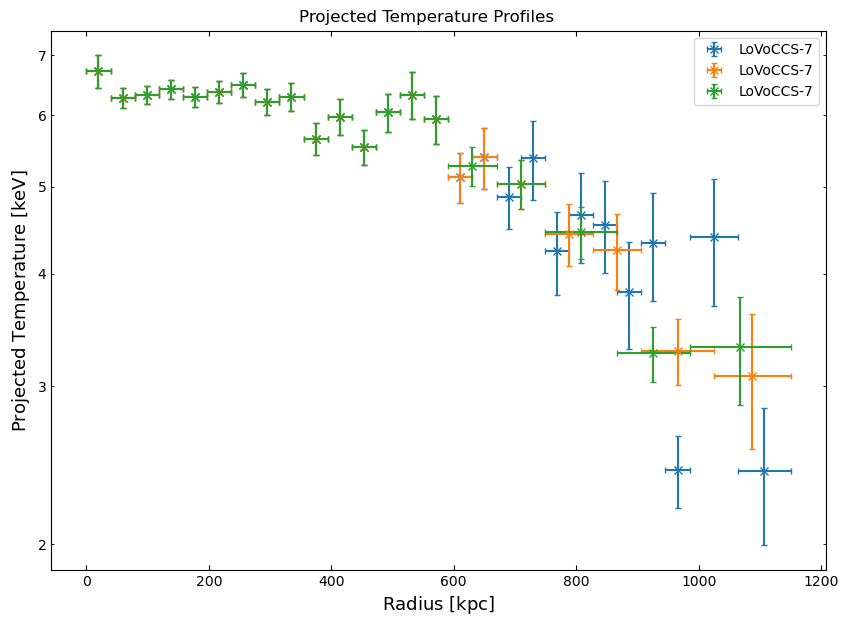

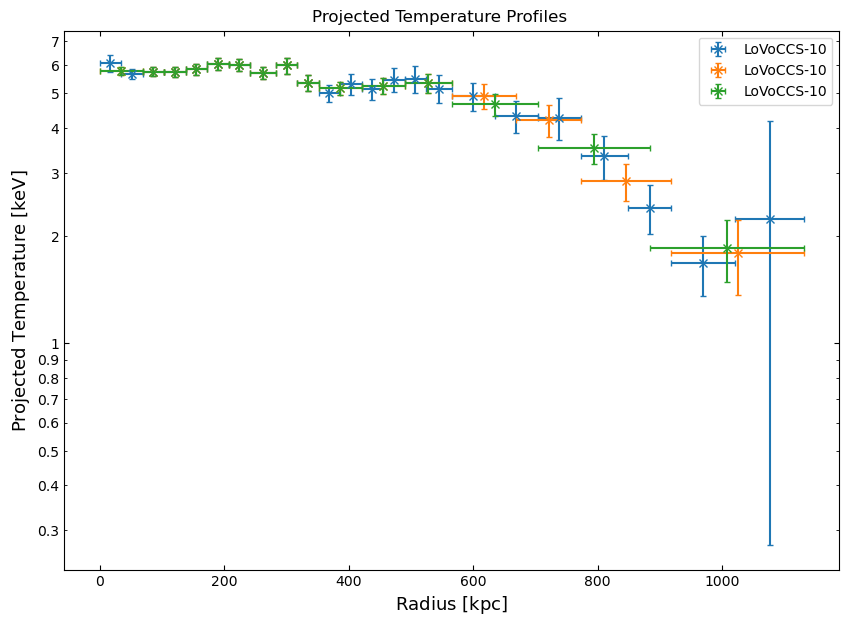

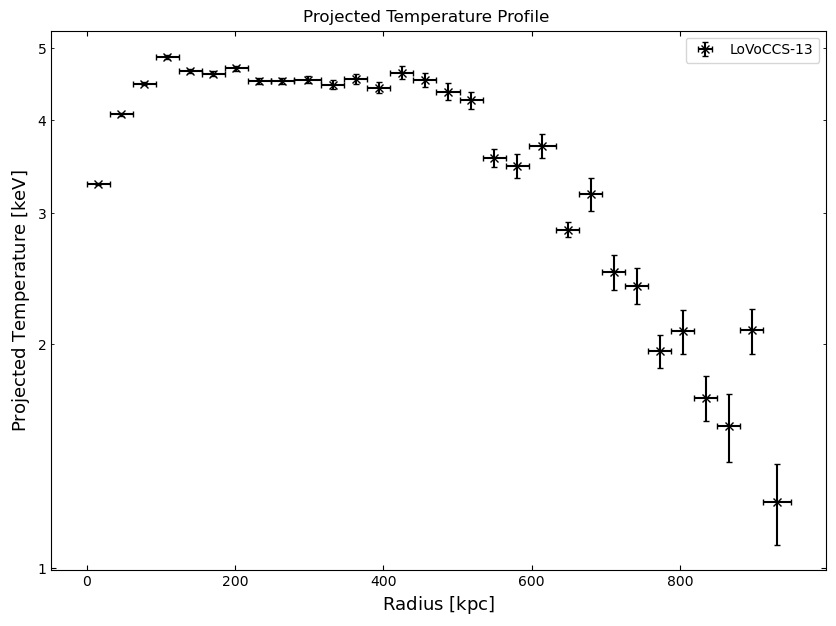

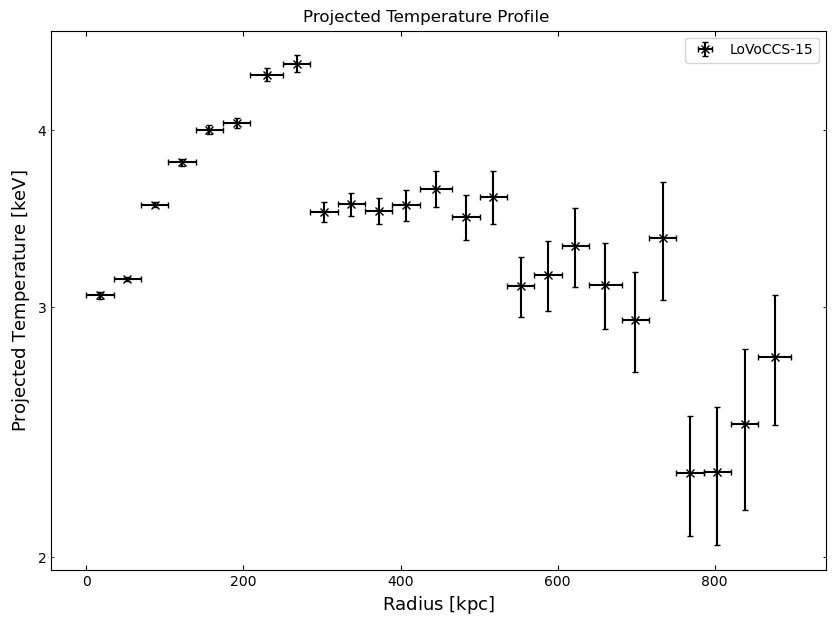

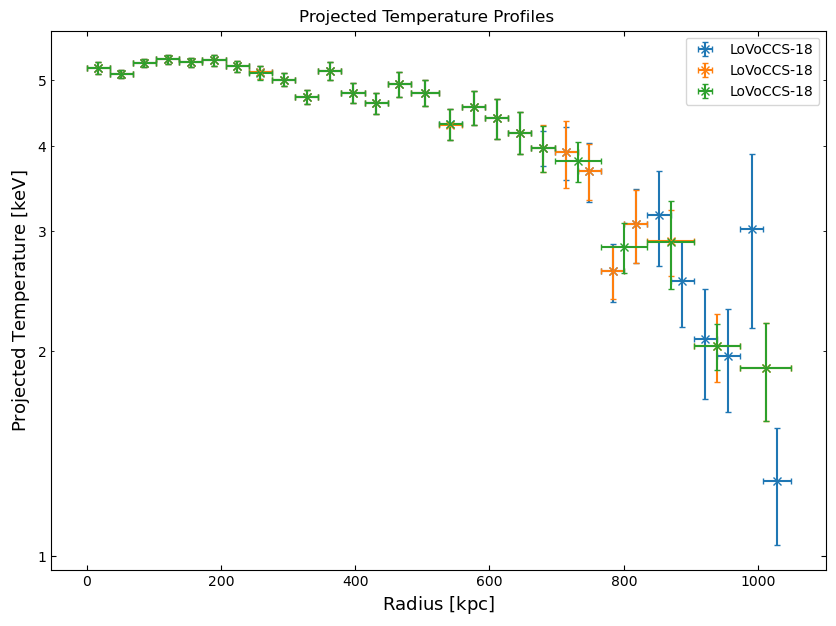

...

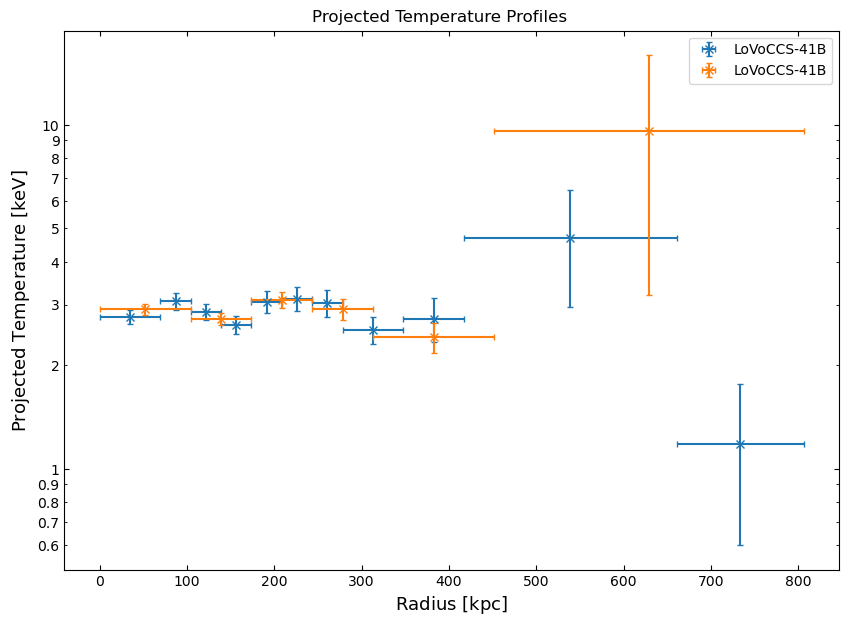

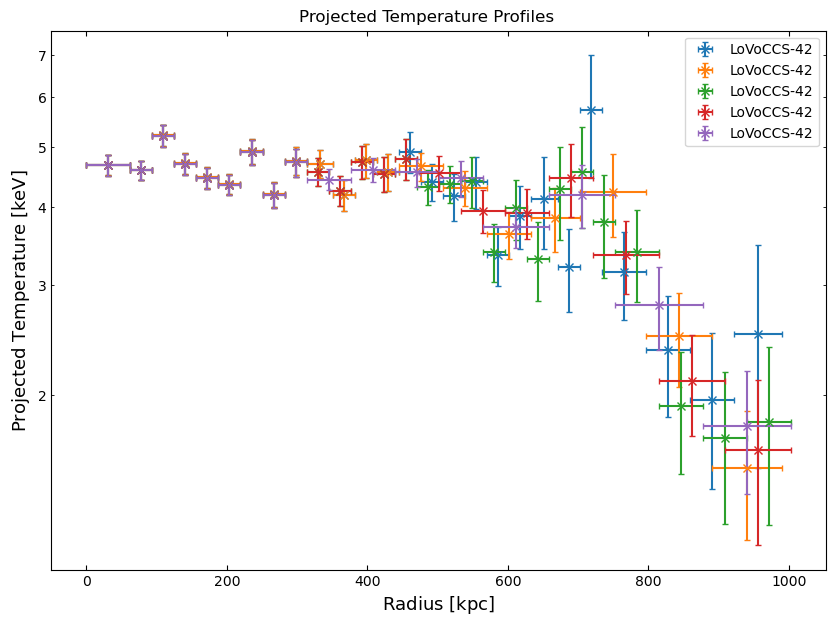

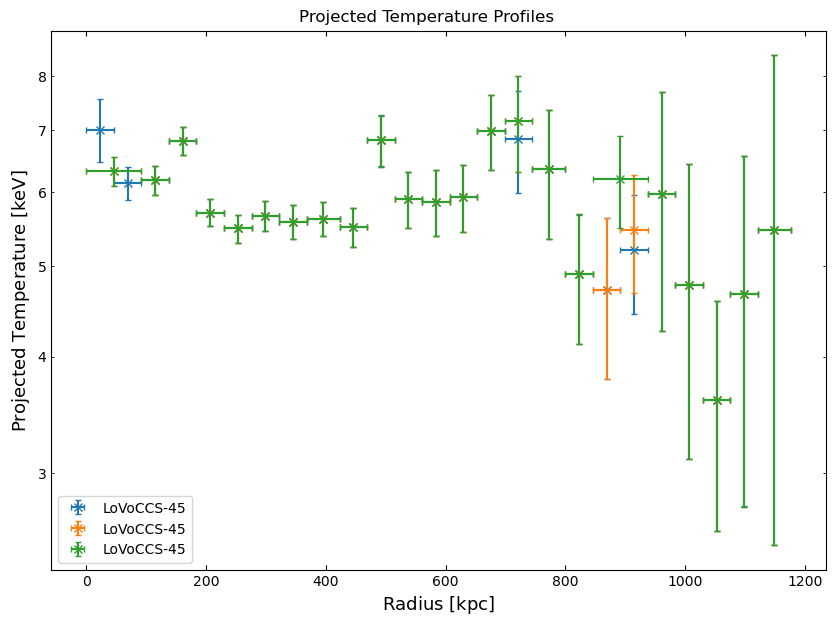

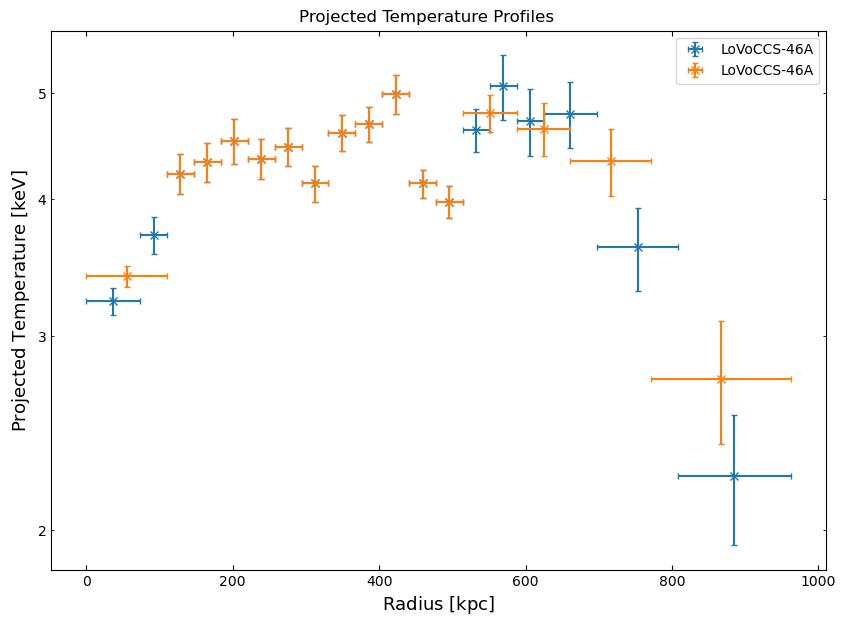

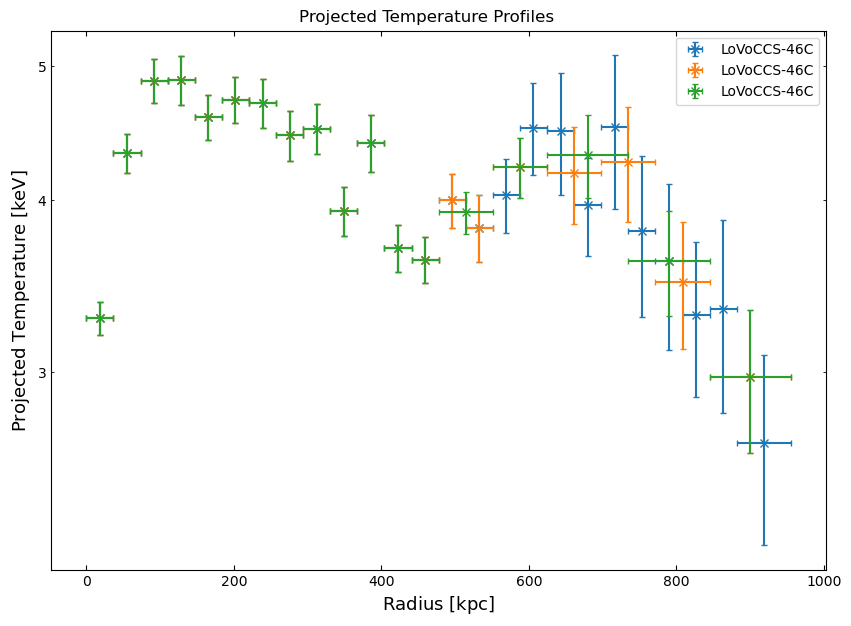

LoVoCCS-48A


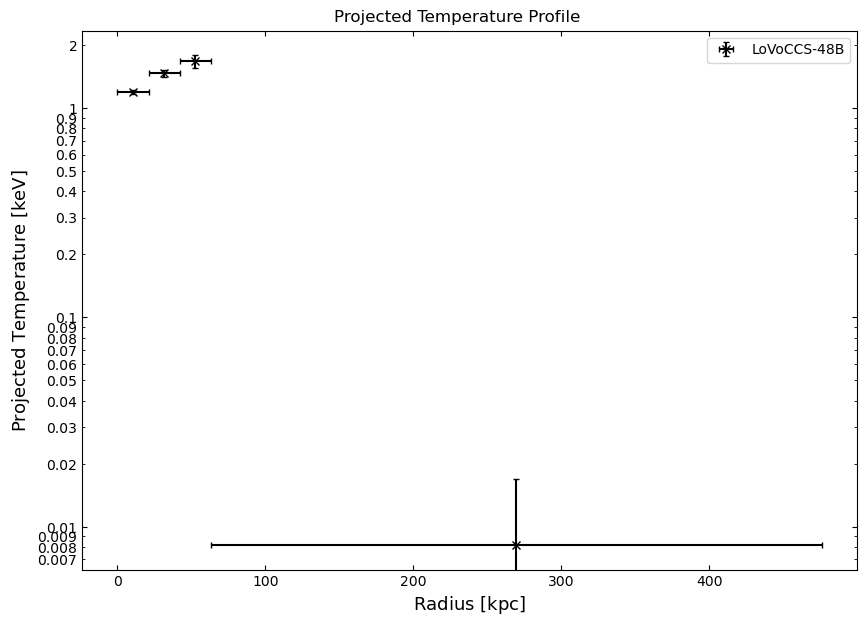

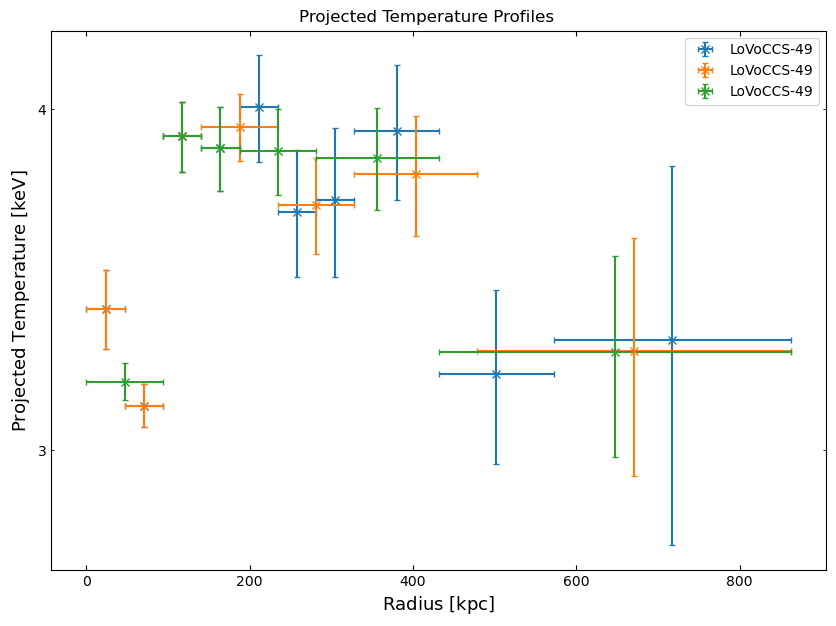

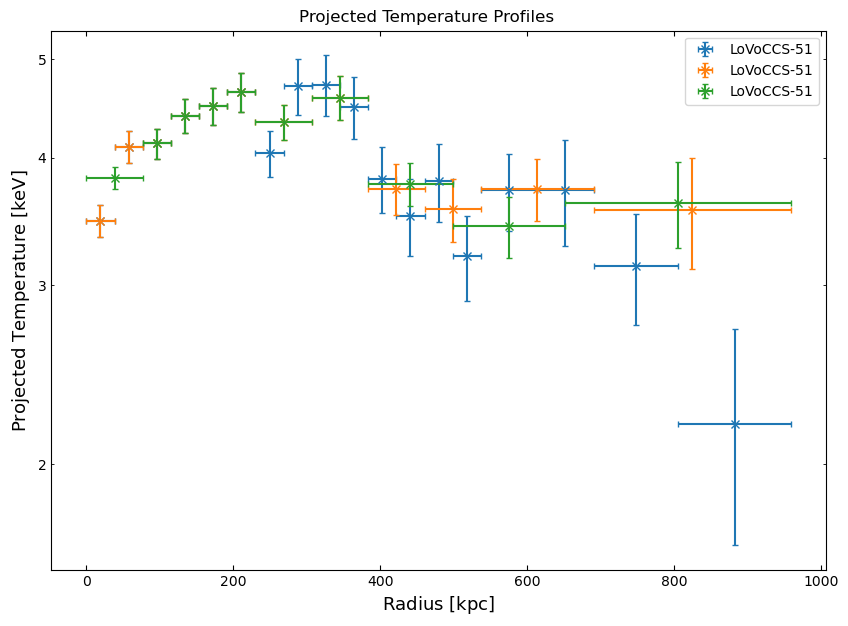

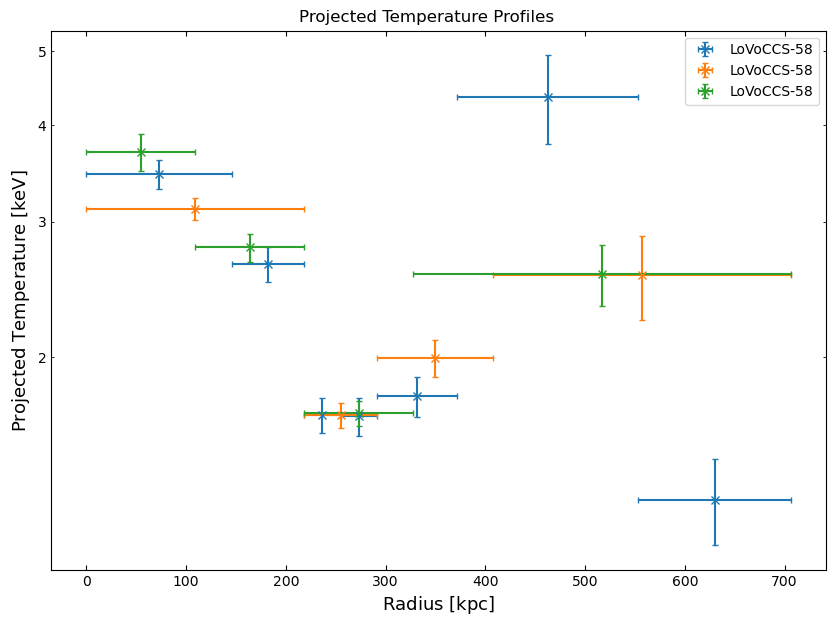

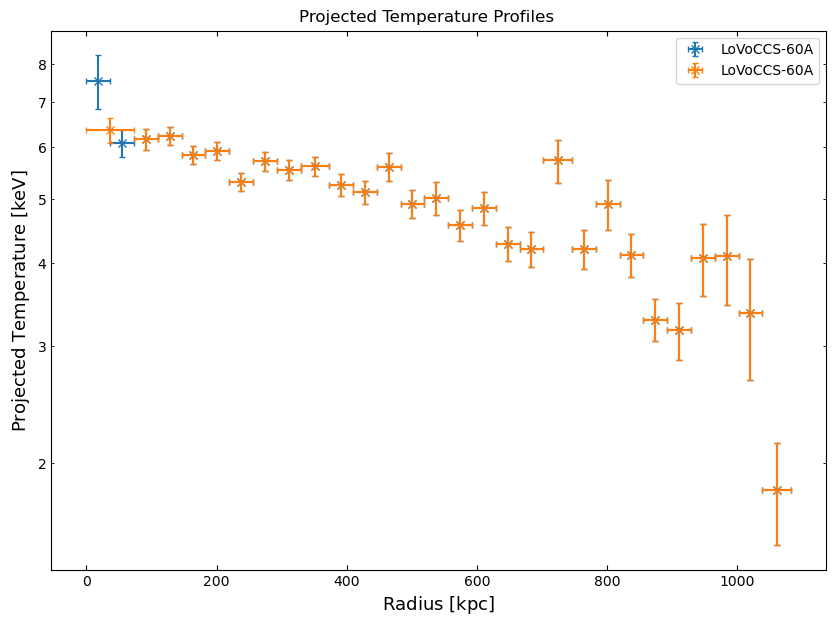

...

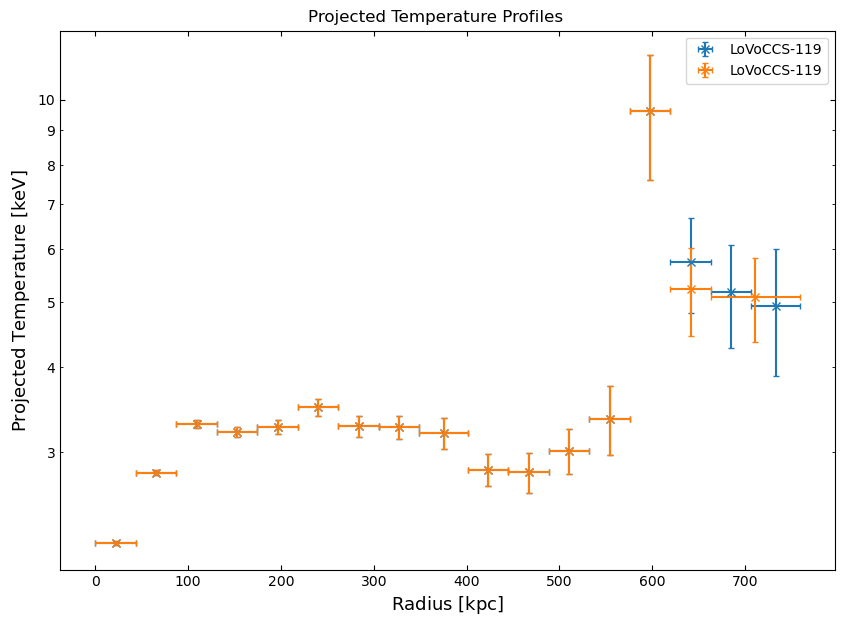

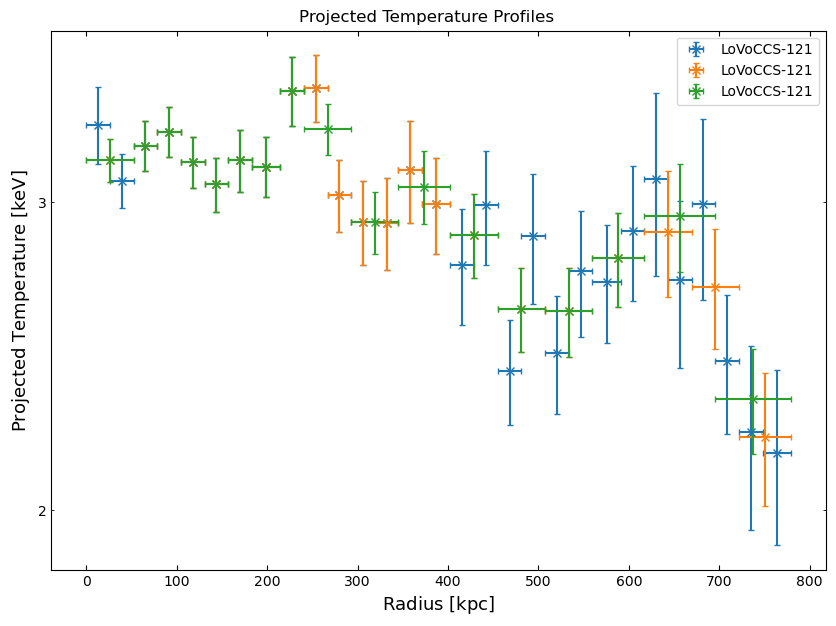

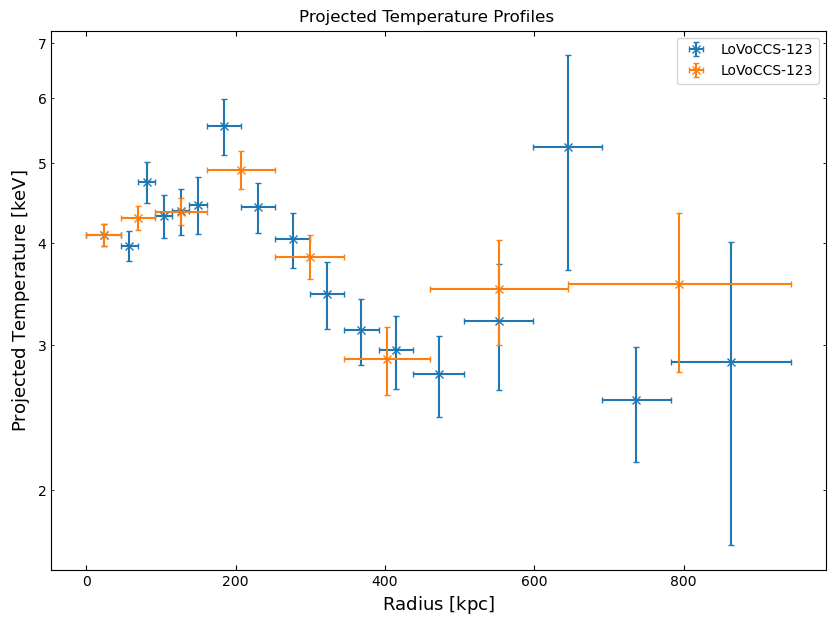

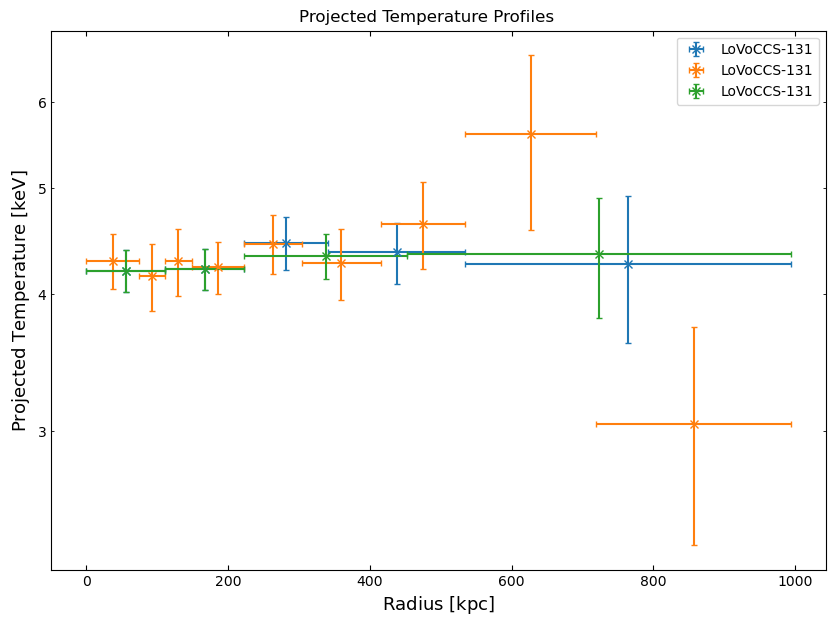

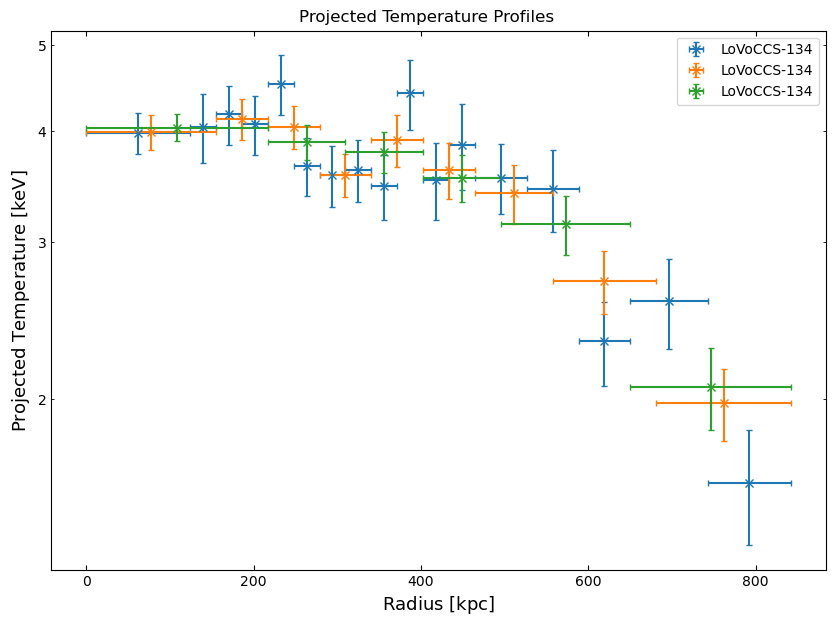

42

In [54]:
got_pt = 0
for src in srcs:
    try:
        pt = src.get_proj_temp_profiles()
        got_pt += 1
        file_name = "{n}_tproj_toR500.pdf".format(n=src.name)
        if isinstance(pt, list):
            pt = BaseAggregateProfile1D(pt)
            pt.view(xscale='linear', axis_formatters=forms, save_path=fig_dir + file_name)
        else:
            pt.view(xscale='linear', axis_formatters=forms)
            pt.save_view(fig_dir + file_name, xscale='linear', axis_formatters=forms)
        
    except NoProductAvailableError:
        print(src.name)
got_pt

### Projected Metallicity

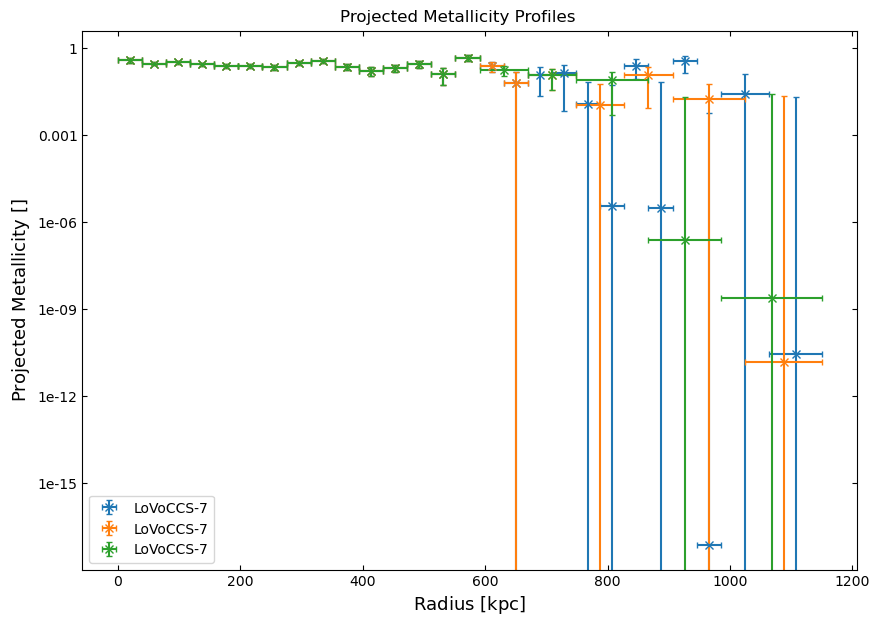

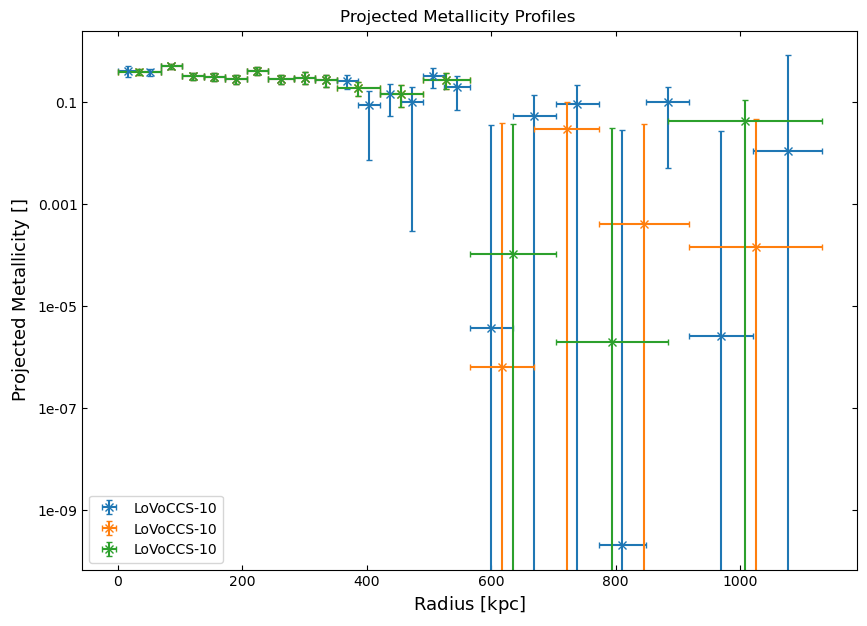

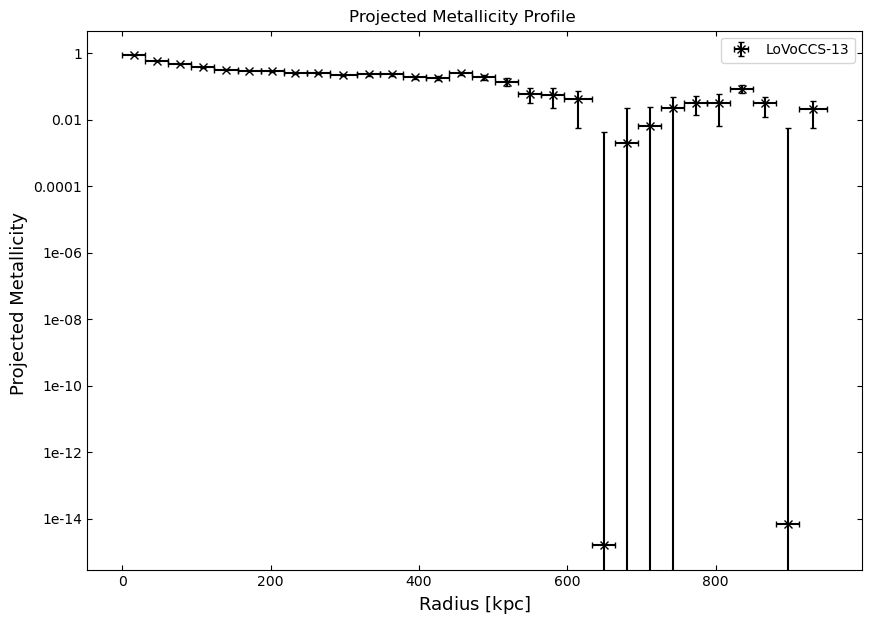

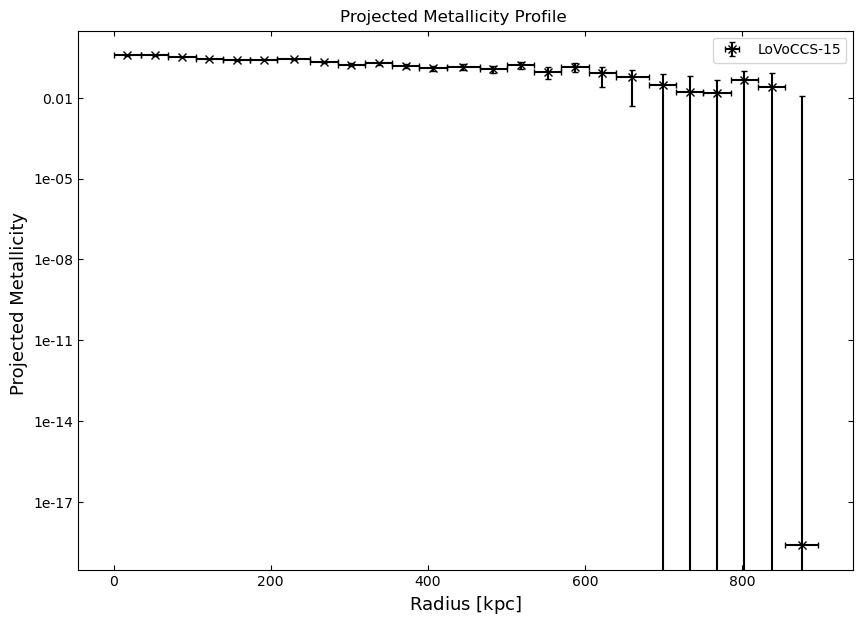

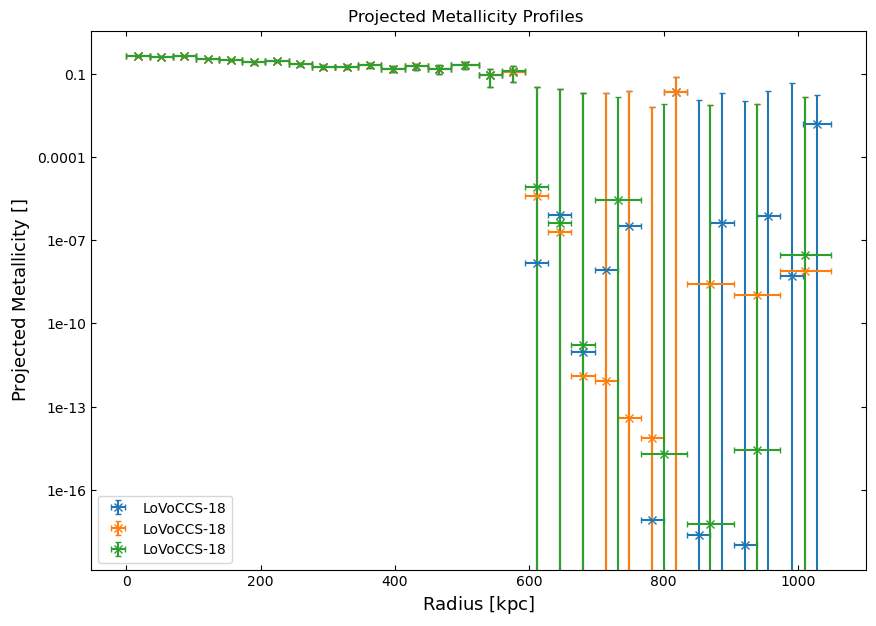

...

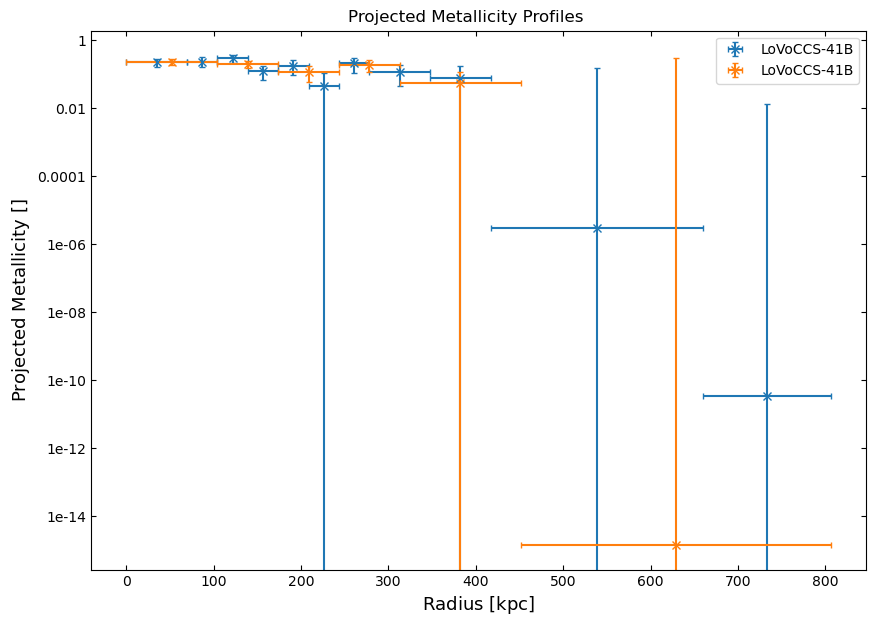

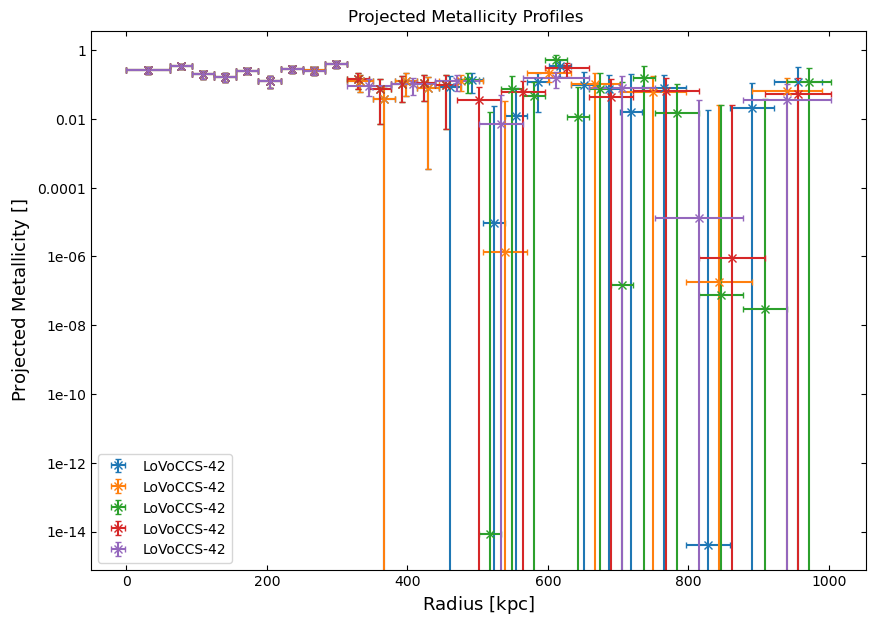

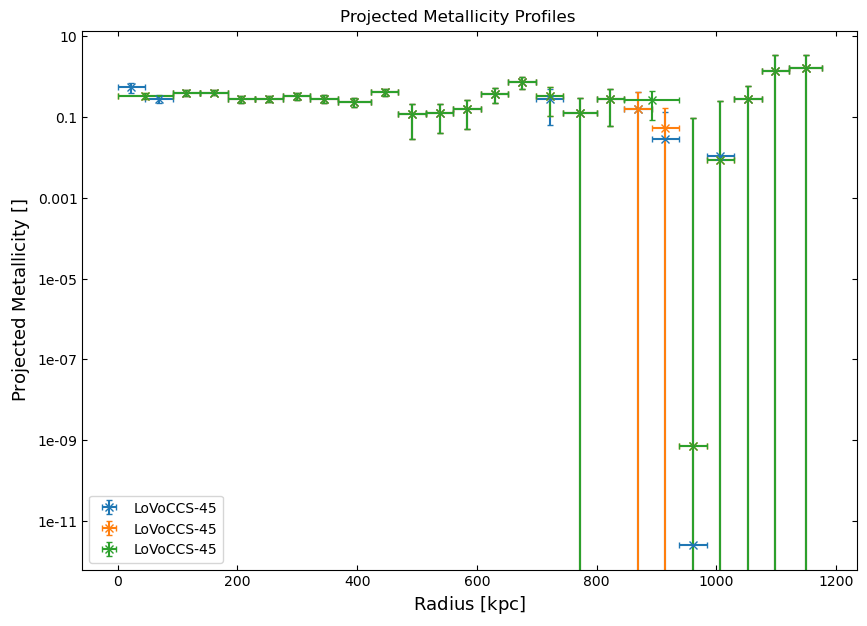

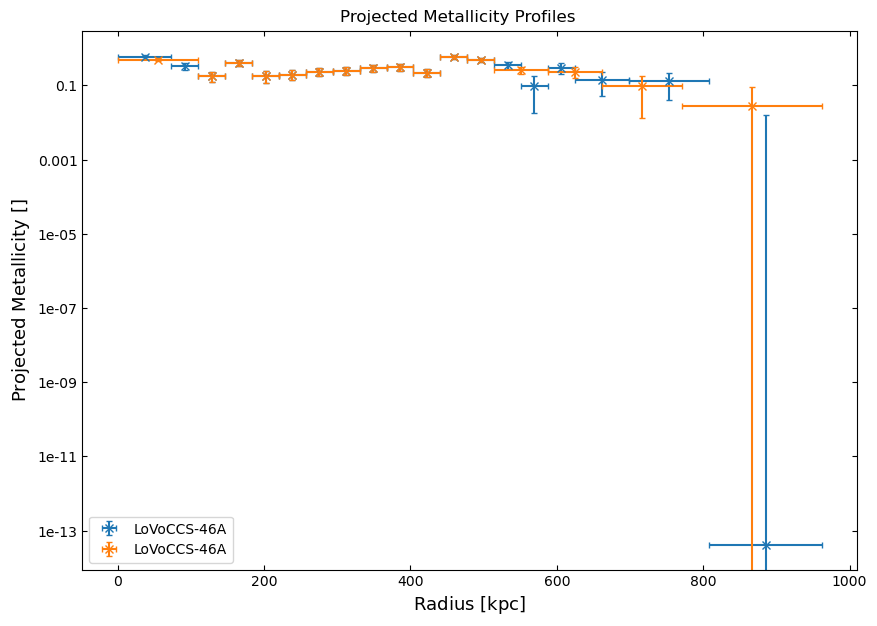

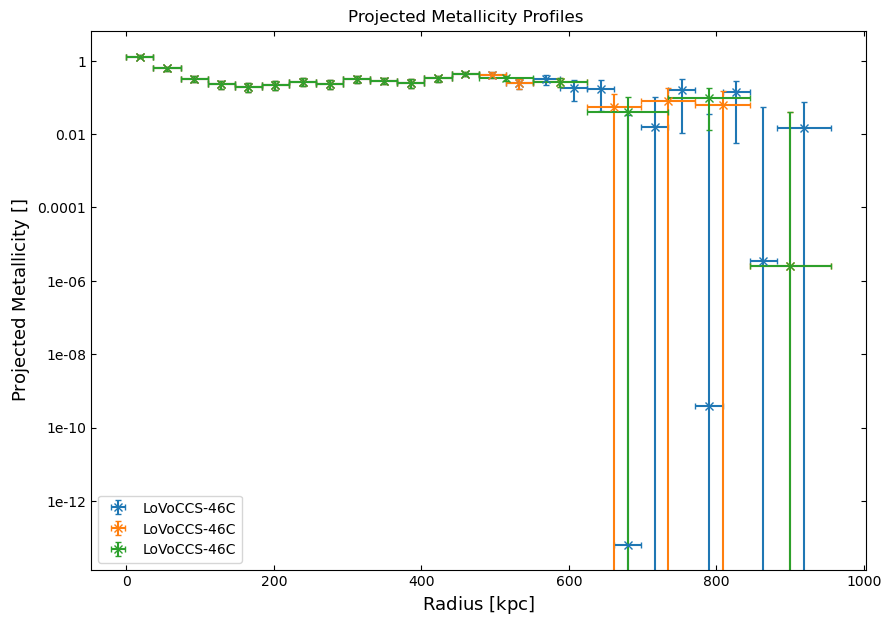

LoVoCCS-48A


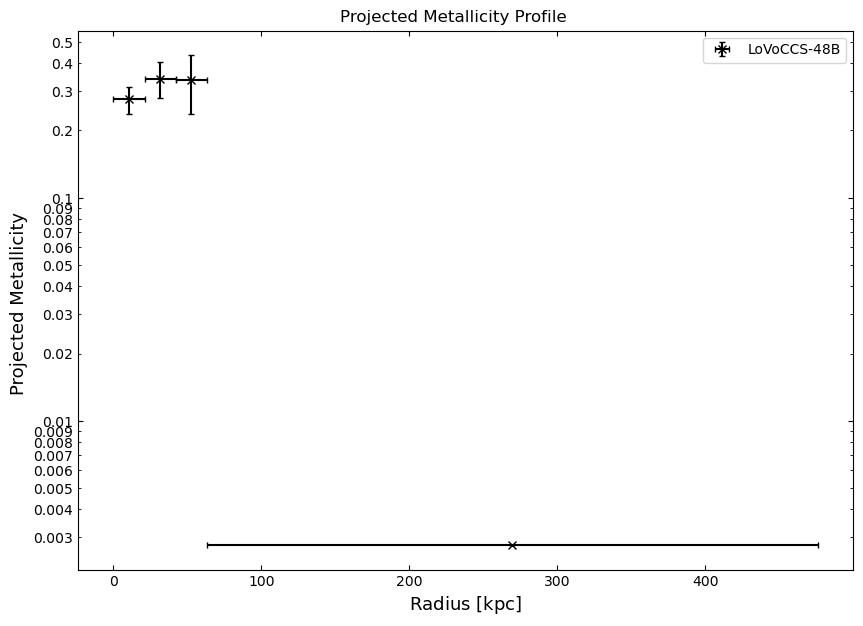

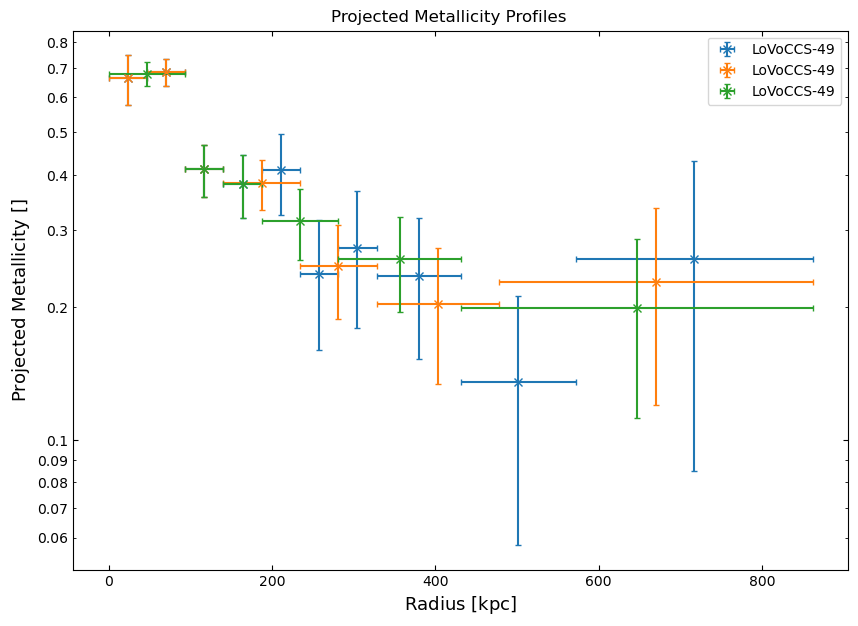

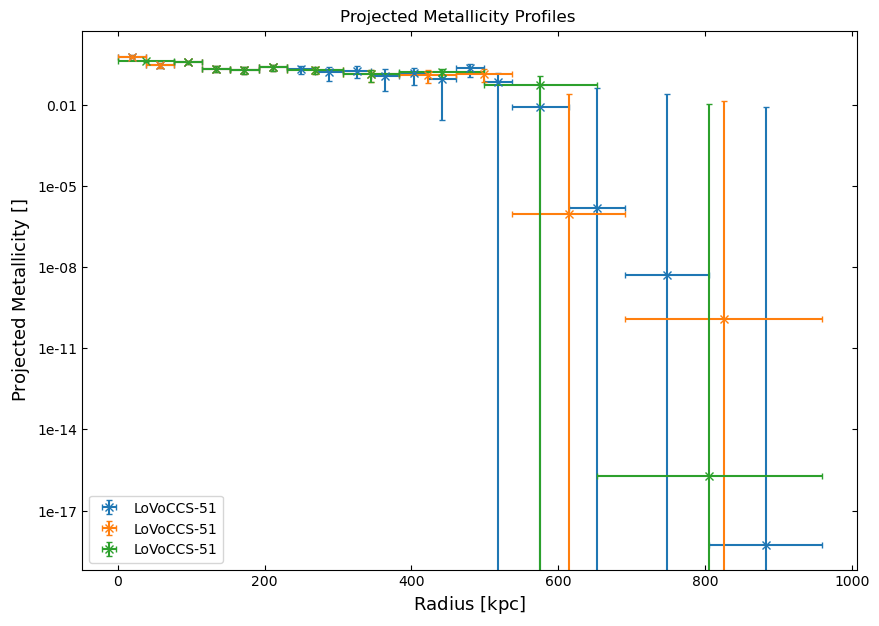

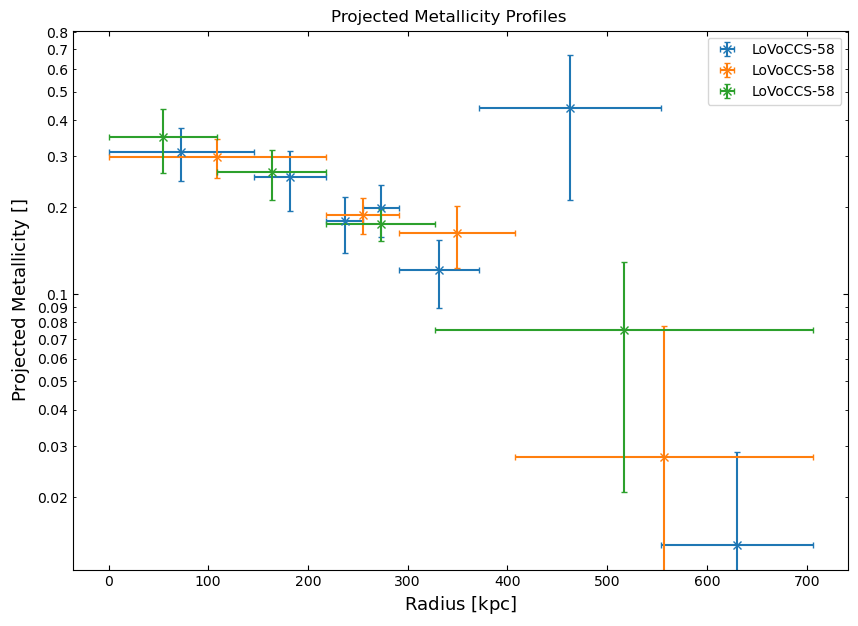

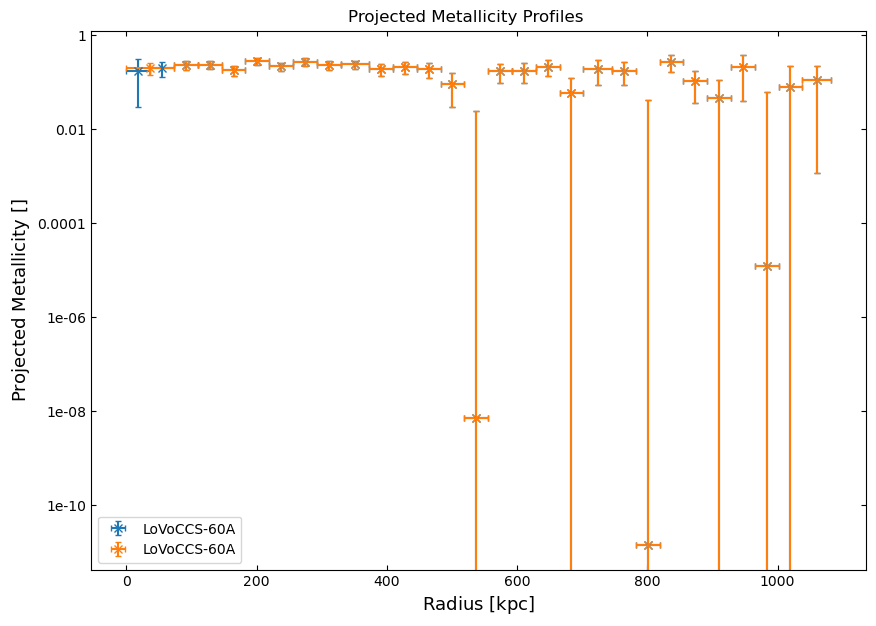

...

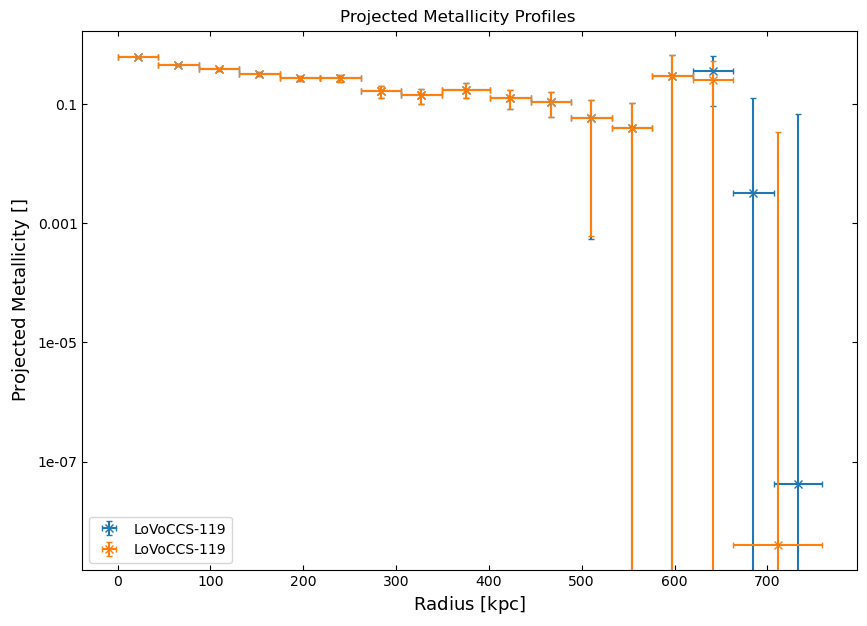

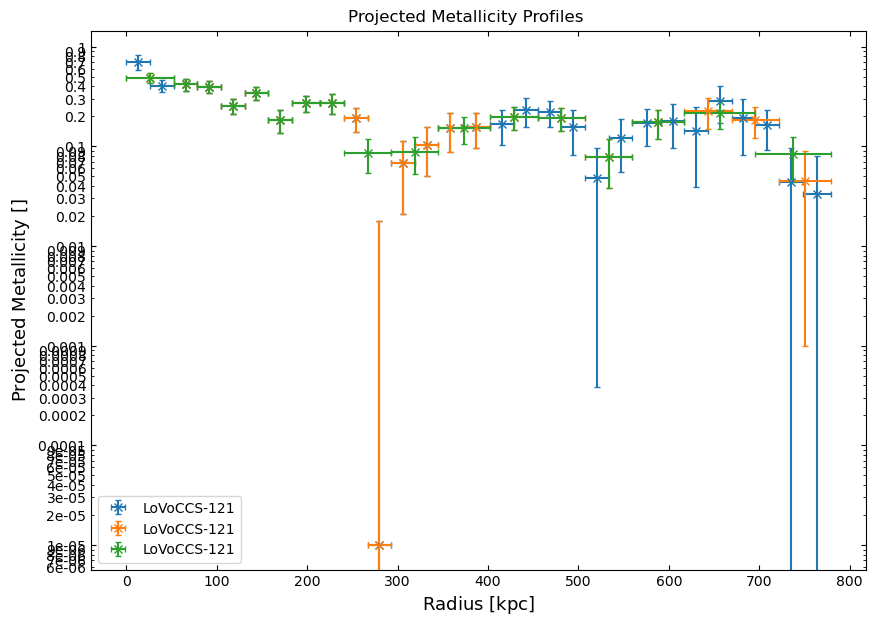

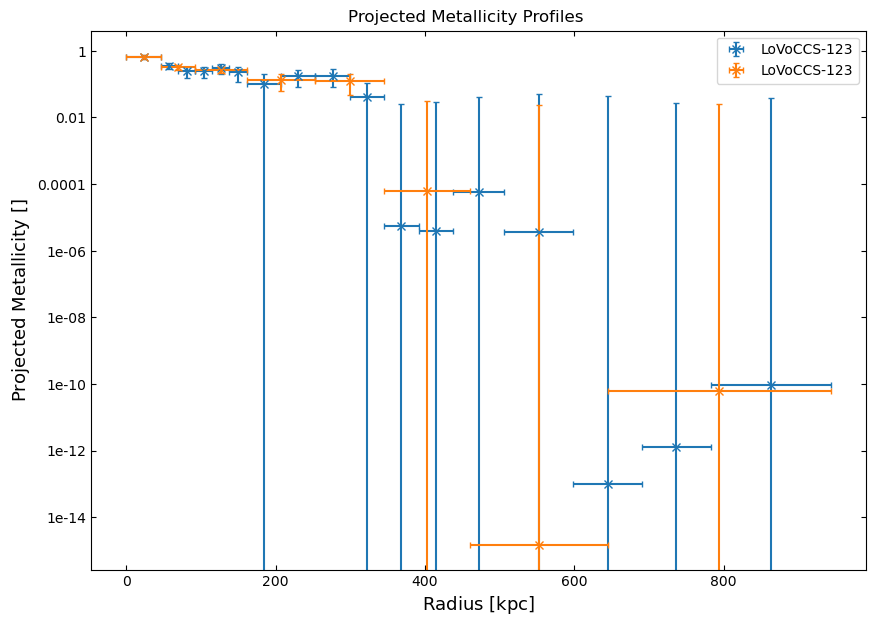

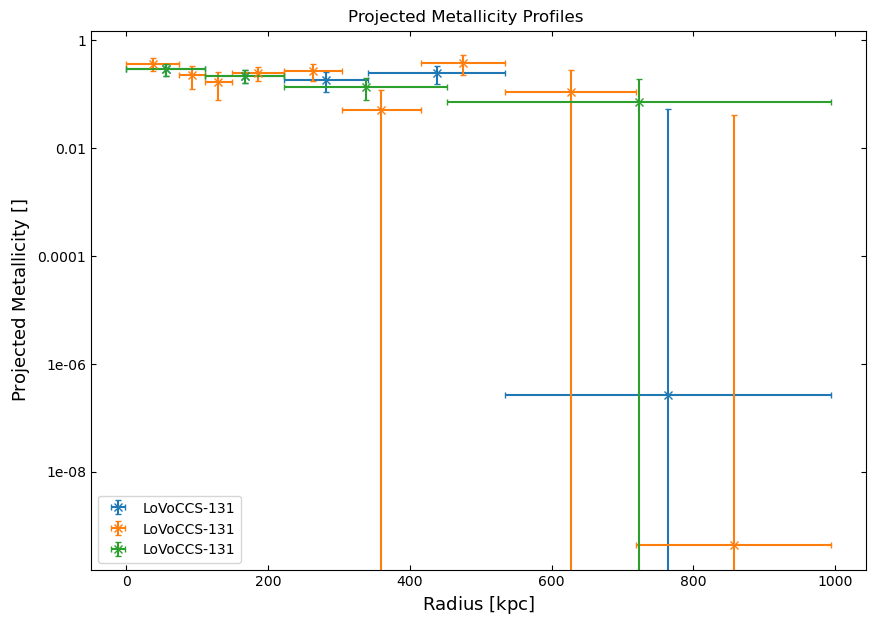

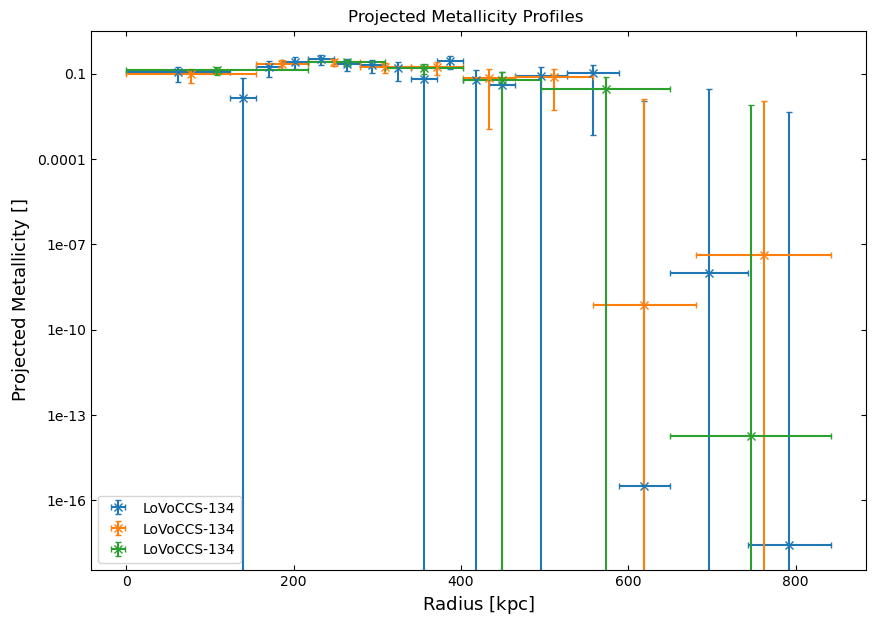

42

In [60]:
got_pm = 0
for src in srcs:
    try:
        pm = src.get_combined_profiles('1d_proj_metallicity')
        
        got_pm += 1        
        file_name = "{n}_metproj_toR500.pdf".format(n=src.name)
        if isinstance(pm, list):
            pm = BaseAggregateProfile1D(pm)
            pm.view(xscale='linear', axis_formatters=forms, save_path=fig_dir_met + file_name)
        else:
            pm.view(xscale='linear', axis_formatters=forms)
            pm.save_view(fig_dir_met + file_name, xscale='linear', axis_formatters=forms)
        
    except NoProductAvailableError:
        print(src.name)
got_pm

## Count-rate map and profile visualisations

Here we create side-by-side visualisations of profiles and ratemaps with annuli overlaid, to aid in diagnostics:

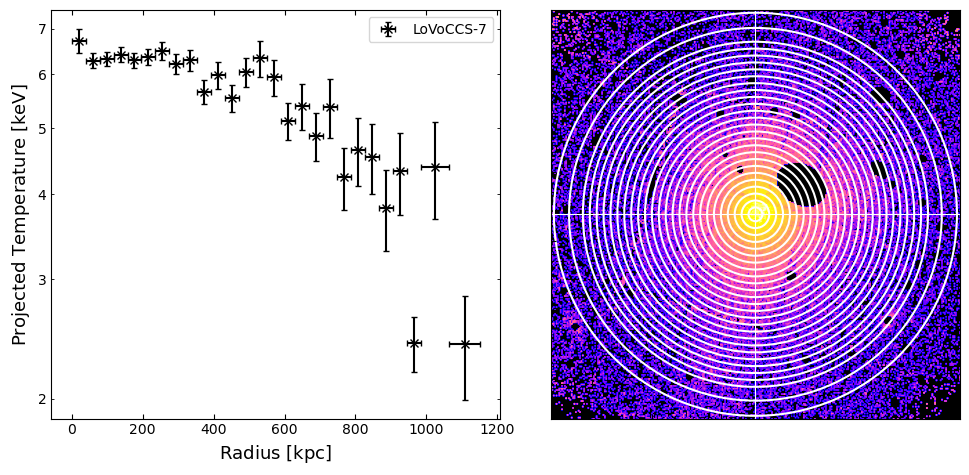

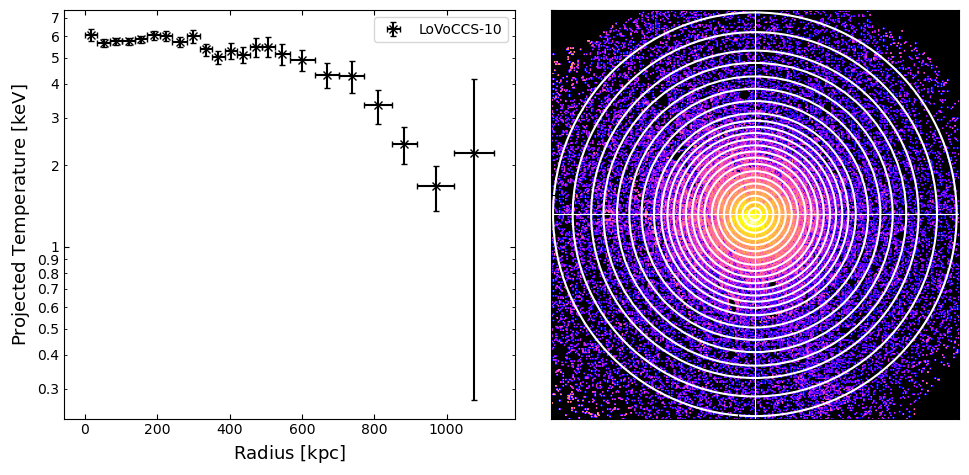

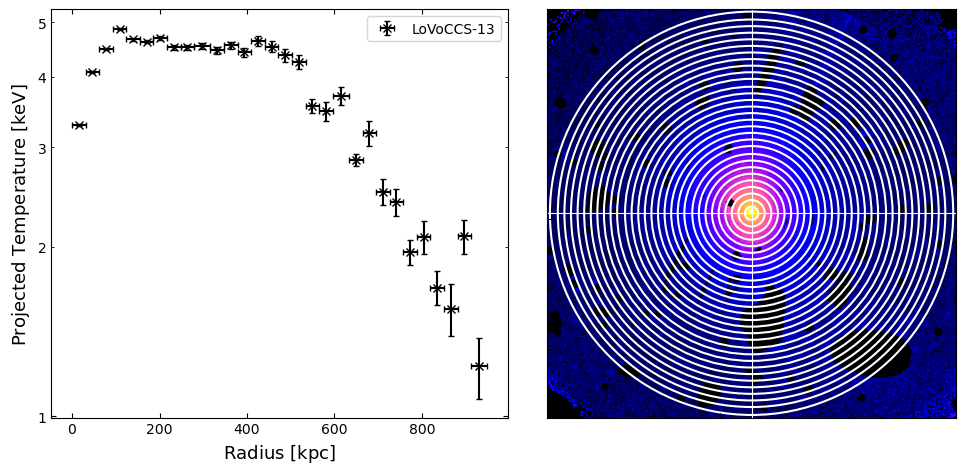

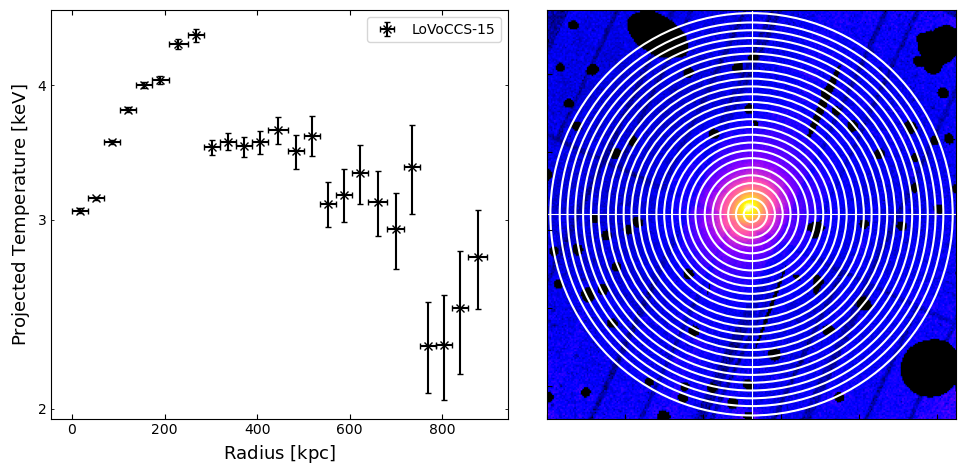

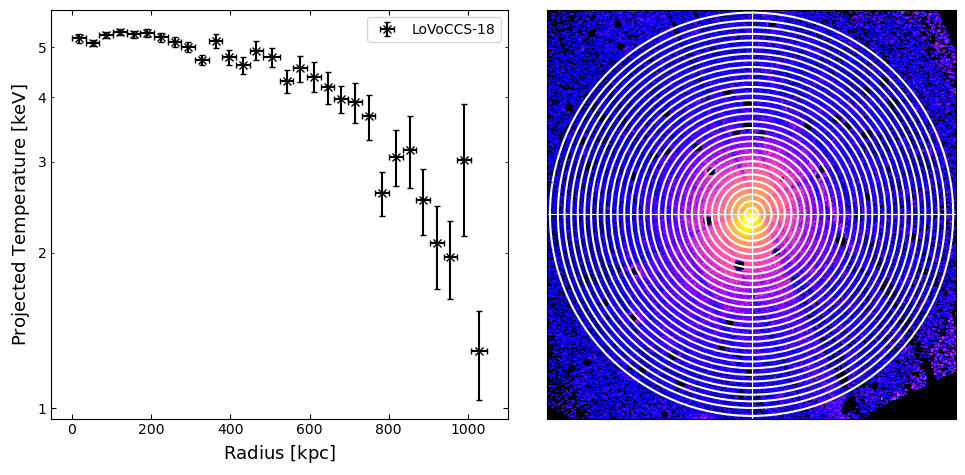

...

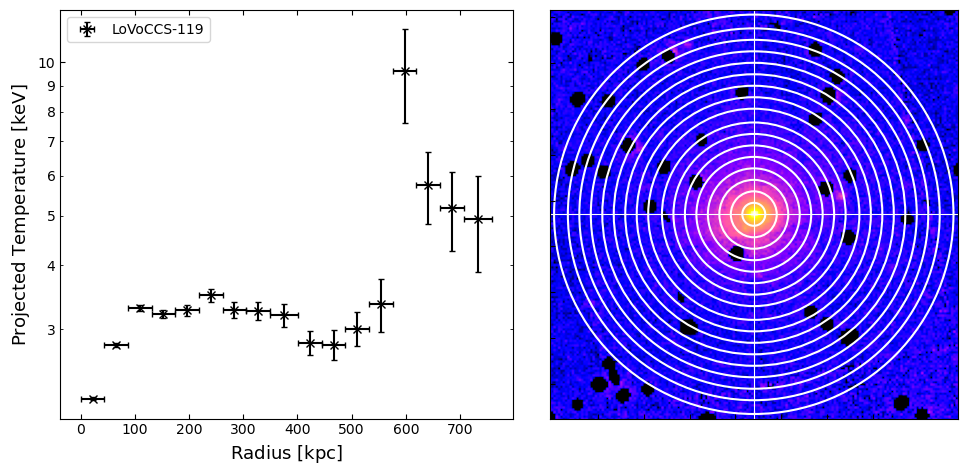

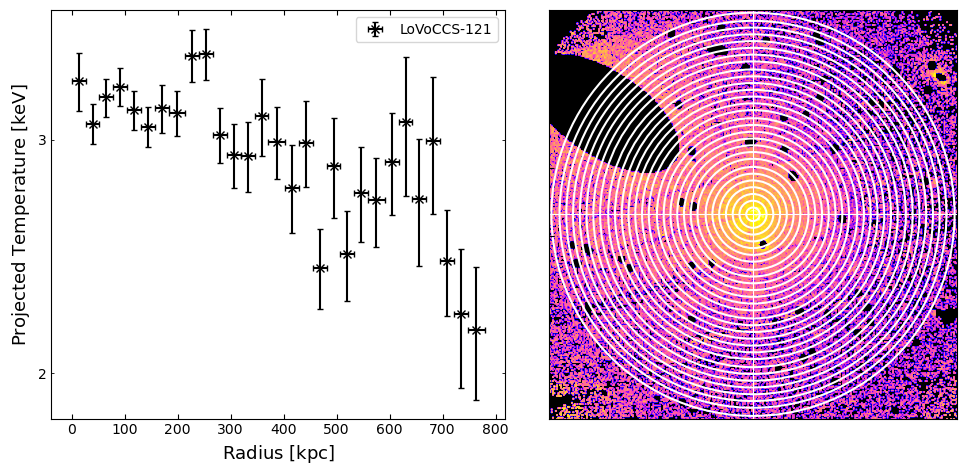

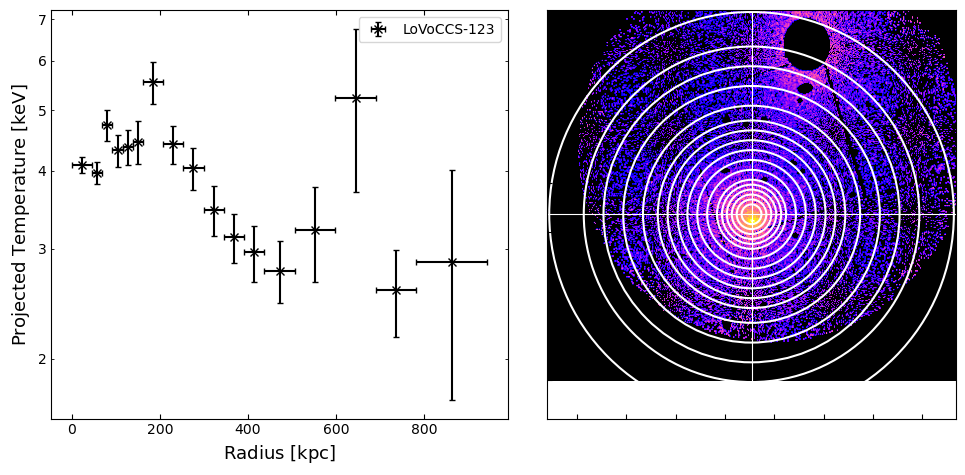

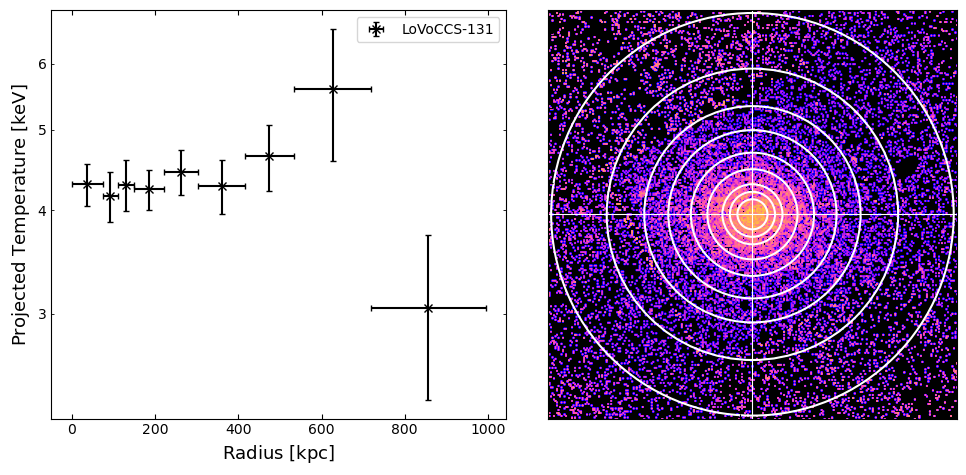

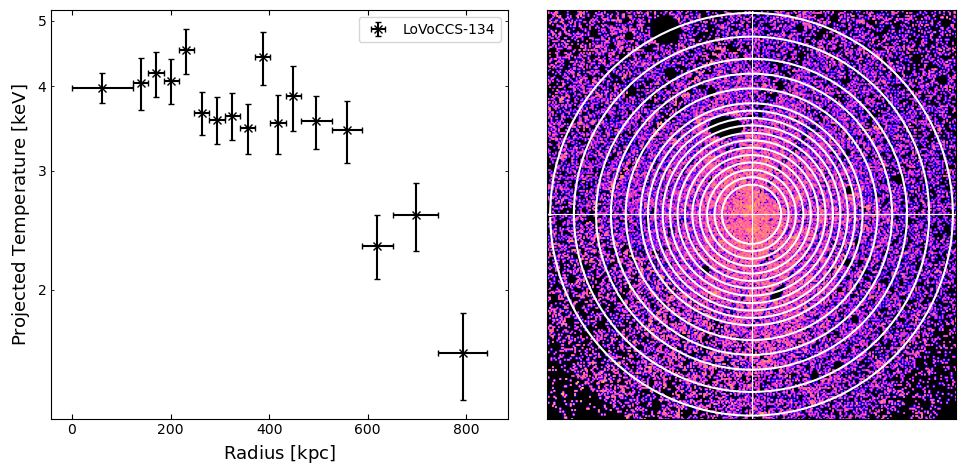

In [88]:
for rad_ind, rad in enumerate(rads):
    src = srcs[rad_ind]
    try:
        tp = src.get_proj_temp_profiles(radii=rad)
        rt = src.get_combined_ratemaps(lo_en=Quantity(0.5, 'keV'), hi_en=Quantity(2.0, 'keV'))

        fig, ax_arr = plt.subplots(1, 2, figsize=(10, 5))
        ax = ax_arr[0]
        tp.get_view(fig, ax, custom_title='', xscale='linear', axis_formatters=forms)

        ax = ax_arr[1]
        pix_rads = (rad/pix_deg_scale(src.ra_dec, rt.radec_wcs)).to('pix')
        pix_cen = rt.coord_conv(src.ra_dec, 'pix')
        x_lims = [(pix_cen[0]-pix_rads[-1]).value-2, (pix_cen[0]+pix_rads[-1]).value+2]
        y_lims = [(pix_cen[1]-pix_rads[-1]).value-2, (pix_cen[1]+pix_rads[-1]).value+2]

        rt.get_view(ax, src.ra_dec, src.get_interloper_mask(), custom_title='', zoom_in=True, 
                    radial_bins_pix=pix_rads.value, manual_zoom_xlims=x_lims, manual_zoom_ylims=y_lims)

        plt.tight_layout()
        file_name = "{n}_tproj_ratemap_toR500_diagnostic.pdf".format(n=src.name)
        plt.savefig(fig_dir_diag + file_name)
        plt.show()
    except NoProductAvailableError:
        pass